# The Sparks Foundation Internship - Task 4
#### Author: Muhammad Hammad Hassan
-------------
#### Obective
1. Perform exploratory data analysis
1. Try to find the hot zones for terrorism
1. Determine the security issues and insights 


--------------
# 1. Loading Assets

### 1.1 Loading Dependencies

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import folium
from folium.plugins import MarkerCluster
from collections import Counter

import warnings
warnings.filterwarnings('ignore')

### 1.2 Loading Dataset

In [ ]:
df= pd.read_csv("globalterrorismdb_0718dist.csv", encoding = "ISO-8859-1")
df.head(10)

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,1.970000e+11,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,1.970000e+11,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,1.970000e+11,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,1.970000e+11,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,1.970000e+11,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


---------------
# 2. Understanding the Dataset and Cleaning
Here we are simply looking at our dataset to familiarize ourselves with it

### 2.1 Structure of Dataset

In [ ]:
sample.shape

(181691, 135)

In [ ]:
# I borrowed this tris trick from Stackoverflow. I'm sharing the link here:
# https://stackoverflow.com/questions/38783027/jupyter-notebook-display-two-pandas-tables-side-by-side

from IPython.display import display_html
from itertools import chain,cycle
def display_side_by_side(*args,titles=cycle([''])):
    html_str=''
    for df,title in zip(args, chain(titles,cycle(['</br>'])) ):
        html_str+='<th style="text-align:center"><td style="vertical-align:top">'
        html_str+=f'<h2>{title}</h2>'
        html_str+=df.to_html().replace('table','table style="display:inline"')
        html_str+='</td></th>'
    display_html(html_str,raw=True)

dt = pd.DataFrame(zip(sample.columns, sample.dtypes),columns=['Column Name','Datatypes'])

dt1 = dt[dt['Datatypes']=='float64']
dt2 = dt[dt['Datatypes']=='int64']
dt3 = dt[dt['Datatypes']=='object']

summary = pd.DataFrame(
    [['Float64',len(dt1)],
    ['Int64',len(dt2)],
    ['Object',len(dt3)]],
    columns=['Datatype','Qty']
)

display_side_by_side(dt2,dt1,dt3,summary, titles=['Int64','Float64', 'Object', 'Summary'])



,Column Name,Datatypes
1,iyear,int64
2,imonth,int64
3,iday,int64
5,extended,int64
7,country,int64
9,region,int64
16,vicinity,int64
19,crit1,int64
20,crit2,int64
21,crit3,int64


### 2.2 Cleaning The Dataset & Organizing It

Renaming some columns

In [ ]:
sample.rename(columns={'iyear':'Year','imonth':'Month','iday':'Day','country_txt':'Country','provstate':'state',
                       'region_txt':'Region','attacktype1_txt':'AttackType','target1':'Target','nkill':'Killed',
                       'nwound':'Wounded','summary':'Summary','gname':'Group','targtype1_txt':'Target_type',
                       'weaptype1_txt':'Weapon_type','motive':'Motive'},inplace=True)
sample['Casualities'] = sample.Killed + sample.Wounded

Extracting some selected columns to work on 

In [ ]:
data_selected1=sample[['Year','Month','Day','Country','Region','city','latitude','longitude','AttackType','Killed',
               'Wounded','Target','Group','Target_type','Weapon_type','Casualities']]
data_selected1.head()

,Year,Month,Day,Country,Region,city,latitude,longitude,AttackType,Killed,Wounded,Target,Group,Target_type,Weapon_type,Casualities
0,1970,7,2,Dominican Republic,Central America & Caribbean,Santo Domingo,18.456792,-69.951164,Assassination,1.0,0.0,Julio Guzman,MANO-D,Private Citizens & Property,Unknown,1.0
1,1970,0,0,Mexico,North America,Mexico city,19.371887,-99.086624,Hostage Taking (Kidnapping),0.0,0.0,"Nadine Chaval, daughter",23rd of September Communist League,Government (Diplomatic),Unknown,0.0
2,1970,1,0,Philippines,Southeast Asia,Unknown,15.478598,120.599741,Assassination,1.0,0.0,Employee,Unknown,Journalists & Media,Unknown,1.0
3,1970,1,0,Greece,Western Europe,Athens,37.997490,23.762728,Bombing/Explosion,NaN,NaN,U.S. Embassy,Unknown,Government (Diplomatic),Explosives,NaN
4,1970,1,0,Japan,East Asia,Fukouka,33.580412,130.396361,Facility/Infrastructure Attack,NaN,NaN,U.S. Consulate,Unknown,Government (Diplomatic),Incendiary,NaN


- Since all of the columns containing missing values can be categorized as Missing At Random(MAR). We can delete those respective rows
- "state" and "city" can be removed, while "country" and "region" can be used in their stead.
- "longitude" and "latitude" may not be recorded due to lack of knowledge about exact location. Therefore termed as MAR
- "killed", "wounded", "motive", "casualities" and "target" are such categories which can randomly be missing. Since thse quatities are mainly a hypothesis that a person may be killed or taken a hostage if they haven't been seen for some time. 
- While "summary" is a field that is dependent upon other rows, but those rows are randomly missing values. Therefore, by induction, we can say this field is also MAR.


In [ ]:
data_selected1.dropna(axis=0, inplace=True)
data_selected1.shape

(159946, 16)

Looking at missing values

In [ ]:
data_selected1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 159946 entries, 0 to 181690
Data columns (total 16 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   Year         159946 non-null  int64  
 1   Month        159946 non-null  int64  
 2   Day          159946 non-null  int64  
 3   Country      159946 non-null  object 
 4   Region       159946 non-null  object 
 5   city         159946 non-null  object 
 6   latitude     159946 non-null  float64
 7   longitude    159946 non-null  float64
 8   AttackType   159946 non-null  object 
 9   Killed       159946 non-null  float64
 10  Wounded      159946 non-null  float64
 11  Target       159946 non-null  object 
 12  Group        159946 non-null  object 
 13  Target_type  159946 non-null  object 
 14  Weapon_type  159946 non-null  object 
 15  Casualities  159946 non-null  float64
dtypes: float64(5), int64(3), object(8)
memory usage: 20.7+ MB


---------
# **3. Visualizing Data**

### 3.1 Terorrist Activities Each Year

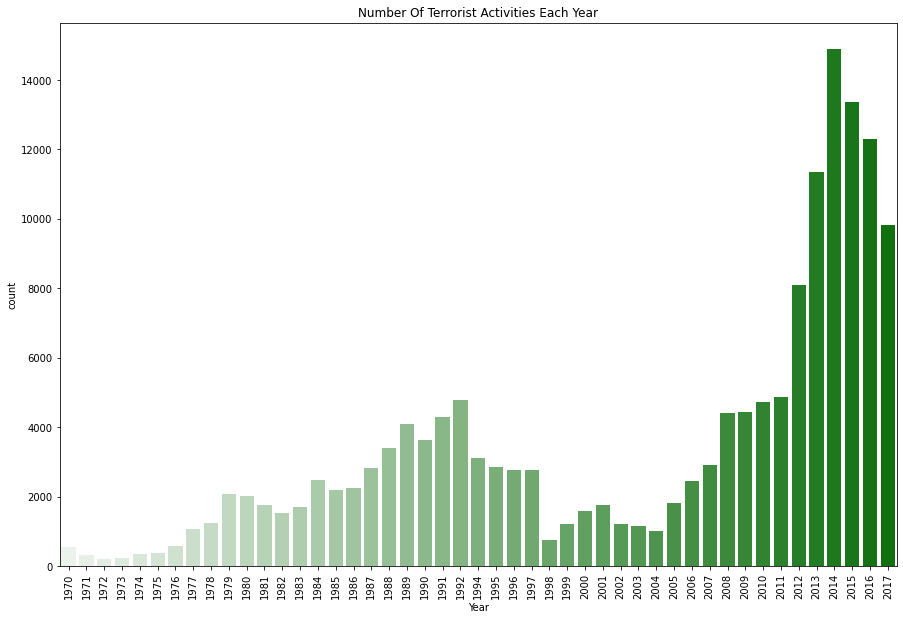

In [ ]:
plt.subplots(figsize=(15,10))
sns.countplot('Year',data=data_selected1,palette="light:g")
plt.xticks(rotation=90)
plt.title('Number Of Terrorist Activities Each Year')
plt.show()

<b>COMMENT:</b> we can visually percieve that with each passing year, terrorist activities are scaling up.

### 3.2 Casualities Each Year 

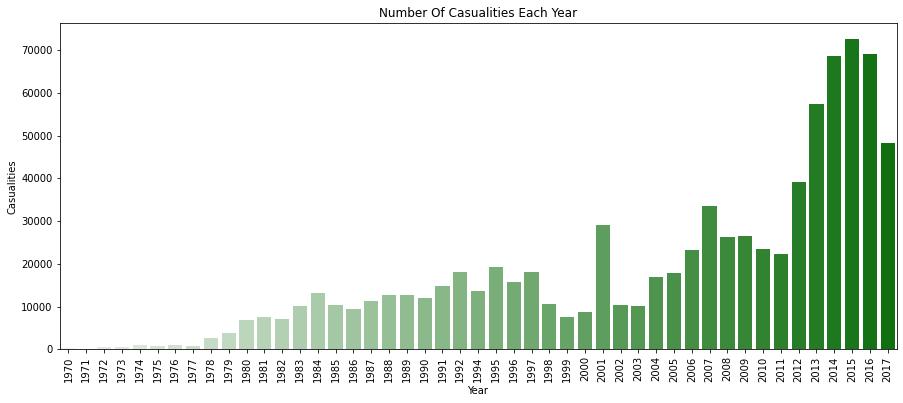

In [ ]:
plt.subplots(figsize=(15,6))
year_cas = data_selected1.groupby('Year').Casualities.sum().to_frame().reset_index()
year_cas.columns = ['Year','Casualities']
sns.barplot(x=year_cas.Year, y=year_cas.Casualities, palette="light:g")
plt.xticks(rotation=90)
plt.title('Number Of Casualities Each Year')
plt.show()

**COMMENT:** relating the previous plot in section 3.1, both the plots show that terrorist activities are inclining exponentially. especially after 2012.

### 3.3 Frequency of Attacks Per Country

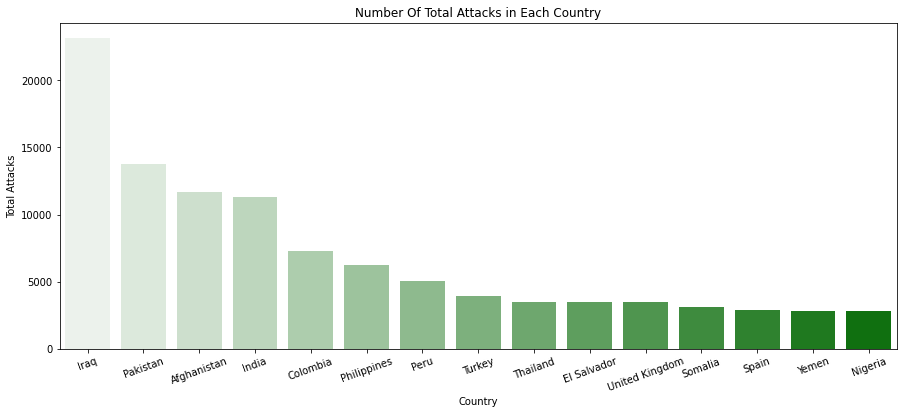

In [ ]:

plt.subplots(figsize=(15,6))
country_attacks = data_selected1.Country.value_counts()[:15].reset_index()
country_attacks.columns = ['Country', 'Total Attacks']
sns.barplot(x=country_attacks.Country, y=country_attacks['Total Attacks'],  palette="light:g")
plt.xticks(rotation=20)
plt.title('Number Of Total Attacks in Each Country')
plt.show()


**COMMENT:** Iraq seems to be facing alot of casualities as the plot shows that this country is most frequently targetted by terrorist.

## 3.2 Weapons Chosen for Attacks

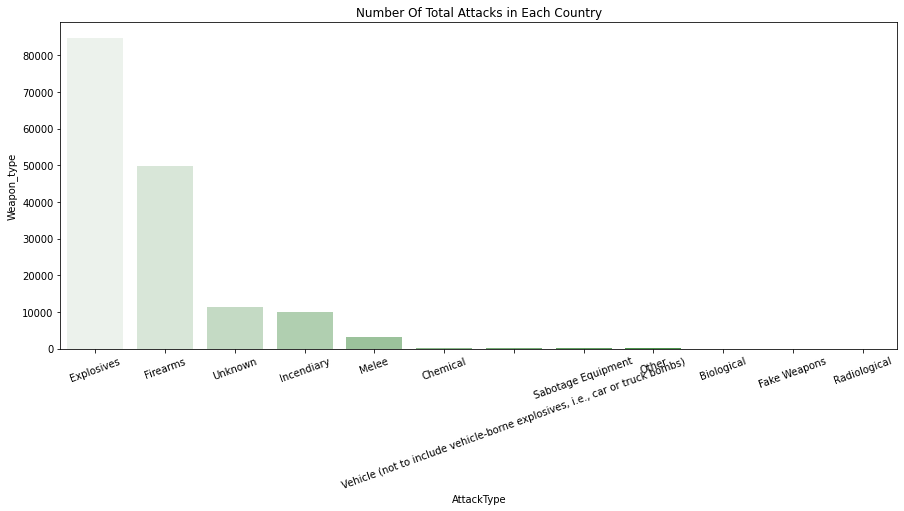

In [ ]:


plt.subplots(figsize=(15,6))
Weapon_Type = data_selected1.Weapon_type.value_counts()[:15].reset_index()
Weapon_Type.columns = ['AttackType', 'Weapon_type']
sns.barplot(x=Weapon_Type.AttackType, y=Weapon_Type['Weapon_type'],  palette="light:g")
plt.xticks(rotation=20)
plt.title('Number Of Total Attacks in Each Country')
plt.show()


**COMMENT:** Looks like by tracking explosives and their related materials, we can identify various terrorist activities which amounts to approx. 50% of the total activities.

Firearms in this regard should also be put under surveillance of local law enforcing authorities.

This way we can identify and even get a chance to stop such malicious activities.

## **Here is a list of all countries you can select from**

In [ ]:
countrynames = data_selected1['Country'].sort_values()

countryname_df = []
row = []
for idx, name in enumerate(countrynames.unique()):
  if idx%5 ==0 and idx!=0:
    countryname_df.append(row)
    row = []
  row.append(name)
else:
  countryname_df.append(row)
pd.DataFrame(countryname_df)


,0,1,2,3,4
0,Afghanistan,Albania,Algeria,Angola,Argentina
1,Armenia,Australia,Austria,Azerbaijan,Bahamas
2,Bahrain,Bangladesh,Barbados,Belarus,Belgium
3,Belize,Benin,Bhutan,Bolivia,Bosnia-Herzegovina
4,Botswana,Brazil,Brunei,Bulgaria,Burkina Faso
5,Burundi,Cambodia,Cameroon,Canada,Central African Republic
6,Chad,Chile,China,Colombia,Comoros
7,Costa Rica,Croatia,Cuba,Cyprus,Czech Republic
8,Czechoslovakia,Democratic Republic of the Congo,Denmark,Djibouti,Dominica
9,Dominican Republic,East Germany (GDR),East Timor,Ecuador,Egypt


Select a country from the list above and assign it to `country_select` variable.

Afterwards, run all related cells **(from 3.4 to 3.7)** to see Country-wise visualizations.

In [ ]:
country_select = "Philippines" 

### 3.4 Attack Type By Each Country

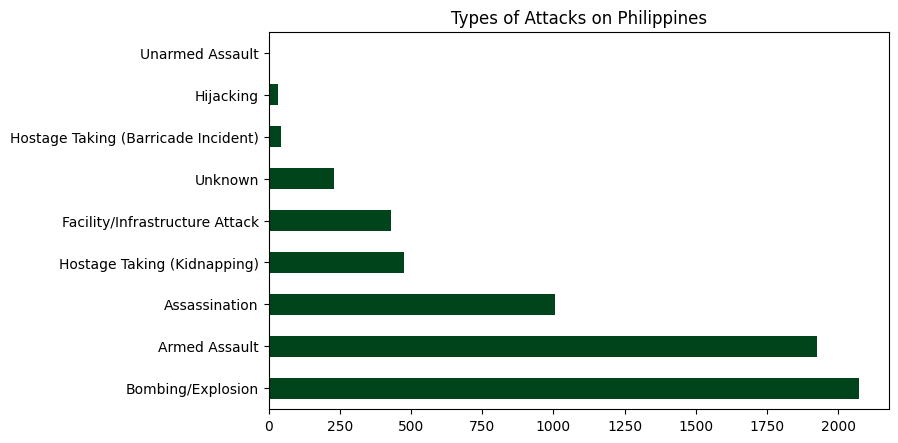

In [ ]:
Attacktype = data_selected1.sort_values(['Country', 'AttackType']).set_index(['Country'])
Attacktype = Attacktype[Attacktype.index==country_select]
Attacktype = Attacktype['AttackType'].value_counts()

myfig = plt.figure(figsize=(8,5), dpi=100)

Attacktype.plot(kind='barh', colormap="Greens_r", title=f"Types of Attacks on {country_select}")


### 3.5 Target Type By Each Country

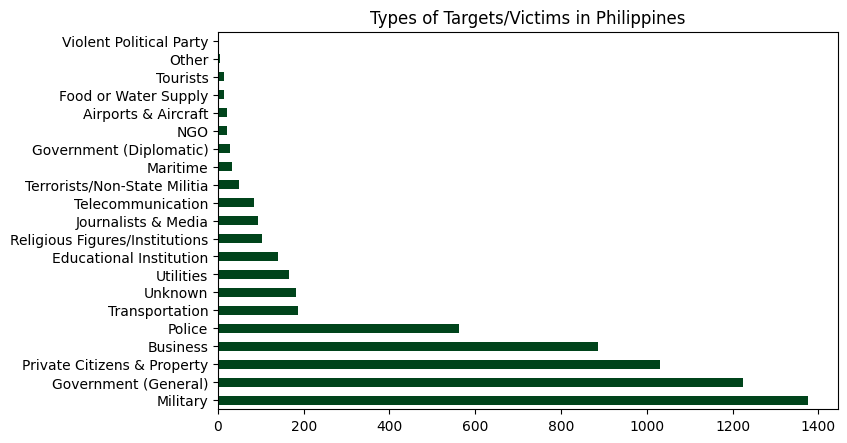

In [ ]:
Targettype = data_selected1.sort_values(['Country', 'Target_type']).set_index(['Country'])
Targettype = Targettype[Targettype.index==country_select]
Targettype = Targettype['Target_type'].value_counts()

myfig = plt.figure(figsize=(8,5), dpi=100)

Targettype.plot(kind='barh', colormap="Greens_r", title=f"Types of Targets/Victims in {country_select}")

### 3.6 Weapon Type used By Each Country

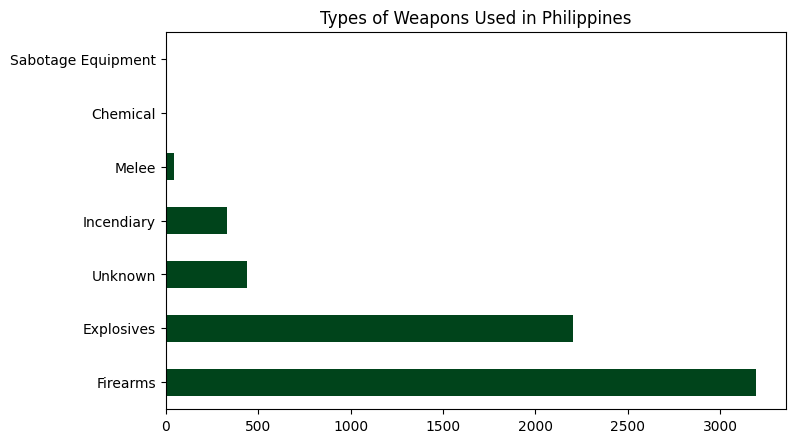

In [ ]:
Weaptype = data_selected1.sort_values(['Country', 'Weapon_type']).set_index(['Country'])
Weaptype = Weaptype[Weaptype.index==country_select]
Weaptype = Weaptype['Weapon_type'].value_counts()

myfig = plt.figure(figsize=(8,5), dpi=100)

Weaptype.plot(kind='barh', colormap="Greens_r", title=f"Types of Weapons Used in {country_select}")

## 3.7 Groups Tormenting Each Country

Country-wise representation of which terrorist groups are causing the most damage.

Groups with less than 10 activities are not shown.

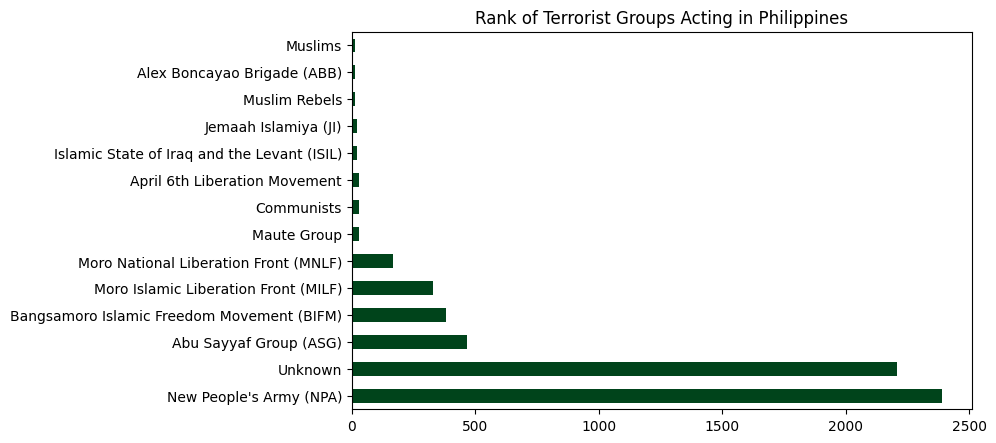

In [ ]:
grptype = data_selected1.sort_values(['Country', 'Group']).set_index(['Country'])
grptype = grptype[grptype.index==country_select]
grptype = grptype['Group'].value_counts()

myfig = plt.figure(figsize=(8,5), dpi=100)

grptype[grptype >10].plot(kind='barh', colormap="Greens_r", title=f"Rank of Terrorist Groups Acting in {country_select}")


# **Note on Security Concerns**

> Security concerns can be analyzed by observing the visualizations from section 3.4 to 3.7. Each country may have their own weaknesses, therefore it is wise to observe each country's specs separately.
>
> From the range of visualizations I have provided, we can identify which areas need more attention or some sort policy to ensure that those elements are not used for malicious purposess.

# **5 Plotting the HOT-Zones**

In [ ]:
year=data_selected1[data_selected1['Year']==2014]
mapData=year.loc[:,'city':'longitude']
mapData=mapData.dropna().values.tolist()

map = folium.Map(location = [0, 50], tiles='CartoDB positron', zoom_start=2) 
markerCluster = folium.plugins.MarkerCluster().add_to(map)
for point in range(0, len(mapData)):
    folium.Marker(location=[mapData[point][1],mapData[point][2]],
                  popup = mapData[point][0]).add_to(markerCluster)
map

**COMMENT:** From here we can visualize the exact location of terrorist activities and how height have those activities taken.

# **THE END**


